In [1]:

#import necessary libraries
import argparse
import random
import os
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [2]:
# define variables needed to train the net
# DEFINE NEW HYPERPARAMETERS HERE!!

batch_size = 64  # lấy 64 ảnh đào tạo 1 lần
img_size = 64   # size ảnh
n_channels = 3  # 3 lớp
n_z = 100      # kích thước của vector Z dùng để đạo tạo ảnh
n_generator = 128  # size of generator's feature map
n_discriminator = 64    # size of discriminator's feature map
n_epochs =  500    
lr_gen = 0.0002          
lr_dis = 0.00005
beta1 = 0.5         
ngpu = 1     

In [3]:
params_path = "/kaggle/working/model-params-64"
try:
    os.mkdir(params_path)     # creates the directory to store extracted images
# raises an error if the directory is not detected
except OSError: 
    print ("Creation of the directory %s failed" % params_path)
else:
    print ("Successfully created the directory %s " % params_path)

Successfully created the directory /kaggle/working/model-params-64 


In [4]:
# run on GPU to train faster, if GPU isn't available use CPU instead
device = torch.device('cuda:0' if(torch.cuda.is_available() and ngpu > 0) else 'cpu')

In [5]:
images = "../input/data-gans"

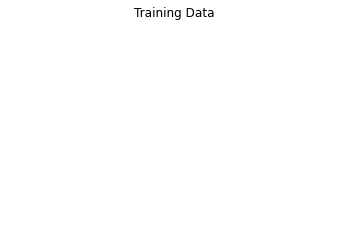

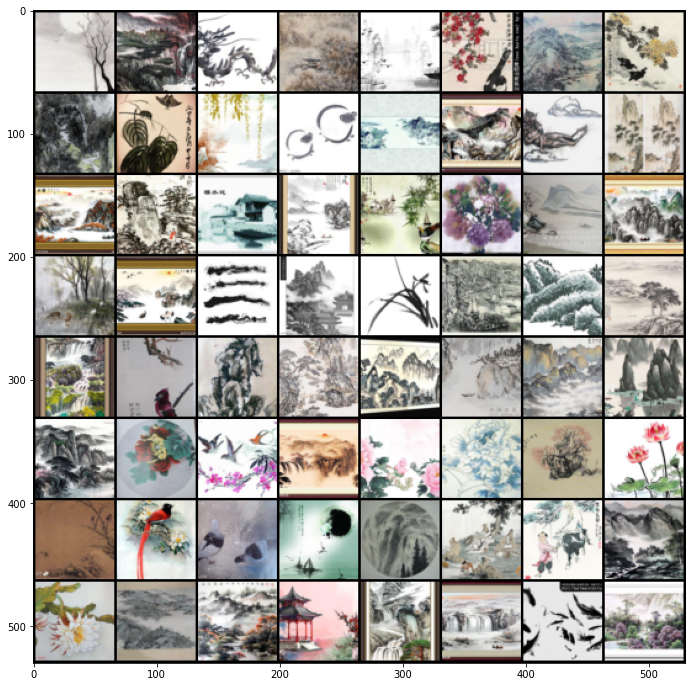

In [6]:

# load data into a PyTorch dataloader

# create the dataset using the PyTorch image folder, which reads in images from a folder
# input the root directory, and a set of transforms. These transforms resize and crop the images
# to the necessary size to be fed into the DCGAN, which is, in this case, a 64x64 image. 
# Data is then converted into a PyTorch tensor and normalized with the values given in the 
# DCGAN paper. 
data = dset.ImageFolder(root=images, transform=transforms.Compose([transforms.Resize(img_size),
                                                                       transforms.CenterCrop(img_size),
                                                                       transforms.RandomHorizontalFlip(p=0.5),
                                                                       transforms.ToTensor(),
                                                                       transforms.Normalize((0.5, 0.5, 0.5), 
                                                                                            (0.5, 0.5, 0.5)),]))

# create the PyTorch dataloader, specify the data used, the batch size, and ensure
# to shuffle the data
dataloader = torch.utils.data.DataLoader(data, batch_size = batch_size, shuffle=True)

# visualize data
batch = next(iter(dataloader))    # get batch from dataloader
plt.axis('off')
plt.title('Training Data')
plt.figure(figsize=(12,12))         # create a figure to visualize images
plt.imshow(np.transpose(vutils.make_grid(batch[0].to(device),      # display data in grid
                                         padding=2, normalize=True).cpu(),(1,2,0)))

In [7]:
#############################################
###             DCGAN CODE                ###
#############################################

In [8]:
# initializes all weights to come from a normal distribution w/given parameters
# given parameters were specified in the DCGAN paper
def weights_init(m):
  classname = m.__class__.__name__
  if classname.find('Conv') != -1:
    nn.init.normal_(m.weight.data, 0.0, 0.02)
  elif classname.find('BatchNorm') != -1:
    nn.init.normal_(m.weight.data, 1.0, 0.02)
    nn.init.constant(m.bias.data, 0)

In [9]:
# creating the generator

class Generator(nn.Module):
  def __init__(self, ngpu):
    super(Generator, self).__init__()
    self.ngpu = ngpu
    self.main = nn.Sequential(
        # can calculate ConvTranspose shaps using below formula:
        # (i - 1) * s + k - 2p, where:
        # i = input, s = stride, k = kernel_size, and p = padding

        # Z latent features vector passes into first Conv layer
        nn.ConvTranspose2d(n_z, n_generator * 8, 4, 1, 0, bias=False),
        nn.BatchNorm2d(n_generator * 8),
        nn.ReLU(True),
        # current shape: (n_generator*8 x 4 x 4)
        nn.ConvTranspose2d(n_generator*8, n_generator*4, 4, 2, 1, bias=False),
        nn.BatchNorm2d(n_generator*4),
        nn.ReLU(True),
        # current shape: (n_generator*4 x 8 x 8)
        nn.ConvTranspose2d(n_generator*4, n_generator*2, 4, 2, 1, bias=False),
        nn.BatchNorm2d(n_generator*2),
        nn.ReLU(True),
        # current shape: (n_generator*2 x 16 x 16)
        nn.ConvTranspose2d(n_generator*2, n_generator, 4, 2, 1, bias=False),
        nn.BatchNorm2d(n_generator),
        nn.ReLU(True),
        # current shape: (n_generator x 32 x 32)
        nn.ConvTranspose2d(n_generator, n_channels, 4, 2, 1, bias=False),
        nn.Tanh()
        # current shape: (n_channels x 64 x 64)
        # this is the same shape as the necessary input image, which 
        # is the necessary shape for the generator to create images
    )
  
  def forward(self, x):
    return self.main(x)

In [10]:
gen = Generator(ngpu).to(device)    # create model instance
gen.apply(weights_init)      # after instantiating model, assign custom weights
print(gen)    # print out model details

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  if __name__ == "__main__":


In [11]:
# discriminator code

# discriminator shapes should be the opposite of the generator,
# as generator was upsampling and discriminator is downsampling

class Discriminator(nn.Module):
  def __init__(self, ngpu):
    super(Discriminator, self).__init__()
    self.ngpu = ngpu
    self.main = nn.Sequential(
        # calculate shape of each layer with this formula:
        # ((i - k + 2p) / s) + 1
        # where i = input, k = kernel size, p = padding, s= stride

        # takes in an input image, so img shape is (3 x 64 x 64)
        nn.Conv2d(n_channels, n_discriminator, 4, stride=2, padding=1, bias=False),
        nn.LeakyReLU(0.2, inplace=True),

        # current shape: (n_generator x 32 x 32)
        nn.Conv2d(n_discriminator, n_discriminator*2, 4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(n_discriminator*2),
        nn.LeakyReLU(0.2, inplace=True),

        # current shape: (n_generator*2 x 16 x 16)
        nn.Conv2d(n_discriminator*2, n_discriminator*4, 4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(n_discriminator*4),
        nn.LeakyReLU(0.2, inplace=True),

        # current shape: (n_generator*4 x 8 x 8)
        nn.Conv2d(n_discriminator*4, n_discriminator*8, 4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(n_discriminator*8),
        nn.LeakyReLU(0.2, inplace=True),

        # current shape: (n_generator*8 x 4 x 4)
        nn.Conv2d(n_discriminator*8, 1, 4, stride=1, padding=0, bias=False),
        nn.Sigmoid()

        # the discriminator only returns 1 value, which corresponds
        # to the probability that an image is either real 
        # or fake
    )
  def forward(self, x):
    return self.main(x)

In [12]:
dis = Discriminator(ngpu).to(device)  # send to GPU and instantiate model
dis.apply(weights_init)     # apply custom weights
print(dis)    # print model

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning: nn.init.constant is now deprecated in favor of nn.init.constant_.
  if __name__ == "__main__":


In [13]:
# creating the optimizers and loss function
criterion = nn.BCELoss()
fixed_noise = torch.randn(64, n_z, 1, 1, device=device)

# values to be used for real and fake labels in the training loop
real_label = 1
fake_label = 0

# use Adam for both generator and discriminator
optimGen = optim.Adam(gen.parameters(), lr=lr_gen, betas=(beta1, 0.999))
optimDis = optim.Adam(dis.parameters(), lr=lr_dis, betas=(beta1, 0.999))

In [14]:
# store loss values in an array to graph
# MODEL TRAINS HERE

img_list = []
generator_losses = []
discriminator_losses = []

for epoch in range(n_epochs):

  # iterates over dataloader, gets one batch at a time
  for i, data in enumerate(dataloader, 0):

    #updating discriminator
    dis.zero_grad()

    # format the batch
    # all the data passed in below is real
    data_todevice = data[0].to(device)
    batch_size = data_todevice.size(0)    # grab batch size from the moved data
    label = torch.full((batch_size,), real_label, dtype = torch.float, device=device)  # creates an array full of ones

    out = dis(data_todevice).view(-1)    # send data to discriminator
    dis_err_real = criterion(out, label)  # find error in discriminator
    dis_err_real.backward()   # backpropogate
    D_x = out.mean().item()    # store in this to pass into discriminator losses array

    # now train with the fake data
    # first create a random z vector
    random_z = torch.randn(batch_size, n_z, 1, 1, device=device)
    #create some fake images by passing this z into generator
    fake_images = gen(random_z)
    label.fill_(fake_label)  # replace all images in label tensor with the fake label
    out = dis(fake_images.detach()).view(-1)  # run fake images through discriminator (.detach makes it require no gradient)
    dis_err_fake = criterion(out, label)    # find loss between discriminator output and generators
    dis_err_fake.backward()   # backpropogate
    D_G_z1 = out.mean().item()

    # sum up errors from real and fake examples, update parameters for discriminator
    dis_error = dis_err_real + dis_err_fake
    optimDis.step()

    # now update the generator
    gen.zero_grad()
    label.fill_(real_label) # fill label with real labels
    out = dis(fake_images).view(-1) # pass fake images through discriminator
    gen_error = criterion(out, label)
    # above steps are done because the fake image should trick the discriminator into 
    # thinking that it is a real image. Thus, the wanted label for the generator's synthesized
    # image should be 1.
    gen_error.backward()
    D_G_z2 = out.mean().item()

    optimGen.step() # update parameters of generator

    # now print training progress every 50 iterations
    if i % 50 == 0:
      # some text formatting:
      # %d is digit characters, /t is a tab, and %.4f is a float to the fourth decimal place
      # vars are inserted at each percentage in the given order
      print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f' 
            % (epoch, n_epochs, i, len(dataloader), dis_error.item(), gen_error.item(), D_x, D_G_z1, D_G_z2))
    generator_losses.append(gen_error.item())
    discriminator_losses.append(dis_error.item())

    # test on randomly generated noise created at the start
    if (i % 500 == 0) or ((epoch == n_epochs-1) and i==len(dataloader)-1):
      # disable gradient 
      with torch.no_grad():
        fake_image = gen(fixed_noise).detach().cpu()  # send the z vector through generator
      img_list.append(vutils.make_grid(fake_image, padding=2, normalize=True))  # append to the image list
    i += 1

[0/500][0/91]	Loss_D: 1.8332	Loss_G: 1.6656	D(x): 0.4970	D(G(z)): 0.5483 / 0.2587
[0/500][50/91]	Loss_D: 9.6063	Loss_G: 0.2138	D(x): 0.3068	D(G(z)): 0.9996 / 0.8112
[1/500][0/91]	Loss_D: 8.1924	Loss_G: 0.9225	D(x): 0.2497	D(G(z)): 0.9971 / 0.4072
[1/500][50/91]	Loss_D: 6.5981	Loss_G: 1.4216	D(x): 0.1153	D(G(z)): 0.9760 / 0.2545
[2/500][0/91]	Loss_D: 5.1607	Loss_G: 1.9329	D(x): 0.1871	D(G(z)): 0.8781 / 0.1485
[2/500][50/91]	Loss_D: 3.0216	Loss_G: 2.4423	D(x): 0.3852	D(G(z)): 0.7334 / 0.0884
[3/500][0/91]	Loss_D: 2.2045	Loss_G: 2.2246	D(x): 0.3984	D(G(z)): 0.5676 / 0.1119
[3/500][50/91]	Loss_D: 2.2215	Loss_G: 2.1556	D(x): 0.4829	D(G(z)): 0.6100 / 0.1180
[4/500][0/91]	Loss_D: 0.7985	Loss_G: 3.1613	D(x): 0.7057	D(G(z)): 0.2835 / 0.0436
[4/500][50/91]	Loss_D: 0.6461	Loss_G: 3.4525	D(x): 0.7729	D(G(z)): 0.0882 / 0.0322
[5/500][0/91]	Loss_D: 0.5513	Loss_G: 2.8659	D(x): 0.8022	D(G(z)): 0.2121 / 0.0579
[5/500][50/91]	Loss_D: 0.6427	Loss_G: 2.5005	D(x): 0.7719	D(G(z)): 0.2374 / 0.0828
[6/500][0/

In [15]:
# save the parameters after training
params_path = "/kaggle/working/model-params-64"
torch.save(gen.state_dict(), params_path + '/van-gogh-gen-64-500')
torch.save(dis.state_dict(), params_path + '/van-gogh-dis-64-500')

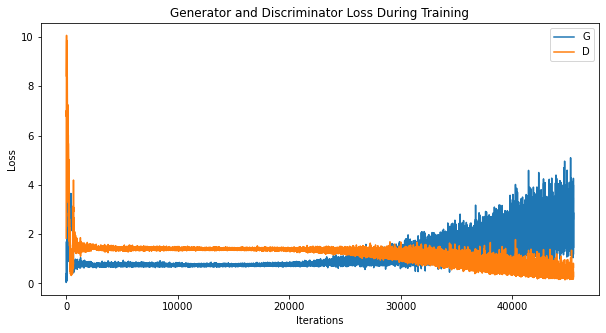

In [16]:
# plot the losses after training
plt.figure(figsize=(10,5))
plt.title('Generator and Discriminator Loss During Training')
plt.plot(generator_losses, label='G')
plt.plot(discriminator_losses, label='D')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.legend()
plt.show()


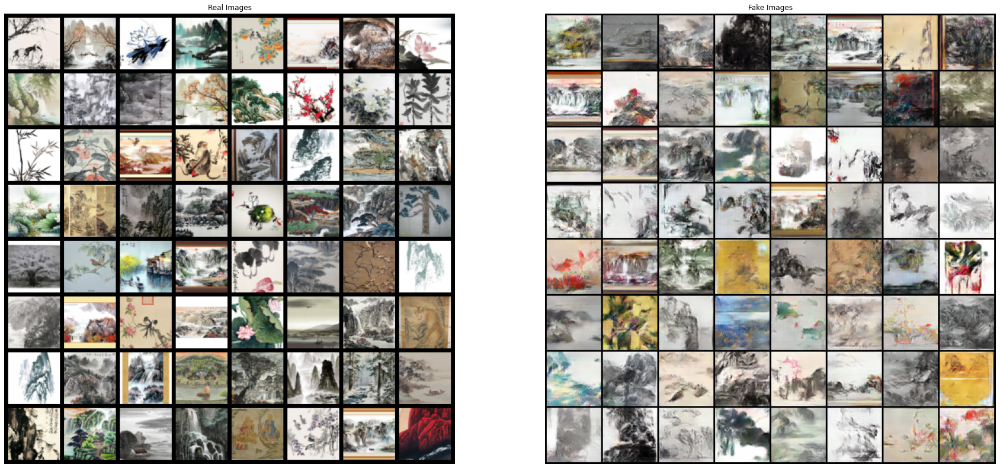

In [17]:
# try generating some images
real_batch = next(iter(dataloader))

#plot images
plt.figure(figsize=(30,30))
plt.subplot(1,2,1)
plt.axis('off')
plt.title('Real Images')
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device), padding=5, normalize=True).cpu(), (1,2,0)))

plt.subplot(1,2,2)
plt.axis('off')
plt.title('Fake Images')
plt.imshow(np.transpose(img_list[-1], (1,2,0)))
plt.show()

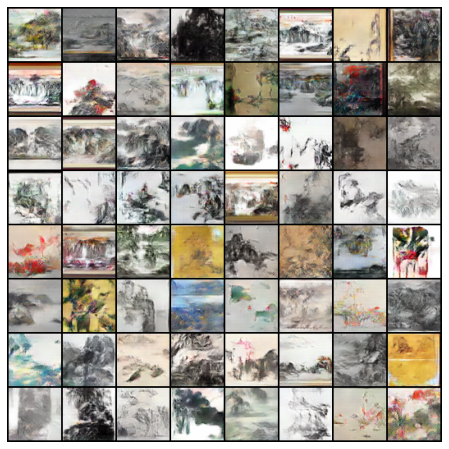

In [18]:
# generates an animation of training progress

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

Random Seed:  1312


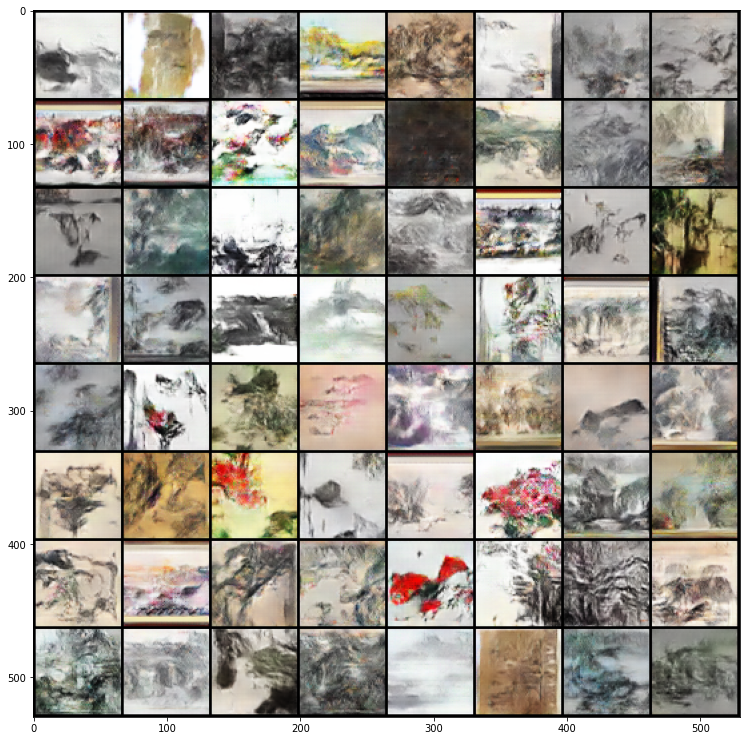

In [19]:
# generating new images

# sets a random seed
manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

fake = gen(torch.randn(64, n_z, 1, 1, device=device)).detach().to('cpu')
plt.figure(figsize=(13, 13))
plt.imshow(np.transpose(vutils.make_grid(fake, padding=2, normalize=True), (1,2,0)))